# Farmland characteristics

Here, we further analyze the NDVI (also the NDMI) index of the polygons identified as farms. The aim now is to answer the following question

* How many planting cycles are there per year? This can be determined by finding the number of NDVI peaks, which should translate to growing seasons of crops.
* How many of these farms are water via irrigation vs. natural rain water? Answering this can be tricky. However, we can study the NDMI index to make inferences.
* Are there missing planting cycles?

In [1]:
import numpy as np
import pandas as pd
import geopandas as gpd
import dask.dataframe as dd
import geopandas as gpd
from scipy.signal import savgol_filter, find_peaks
import holoviews as hv
import hvplot.pandas
import datashader as ds 
import holoviews.operation.datashader as hd
from holoviews.operation.datashader import dynspread
import warnings

hv.extension("bokeh")

warnings.filterwarnings('ignore')

In [2]:
gdf = gpd.read_file("../inference/Trans_Nzoia_1_results_aggregated.gpkg")

In [3]:
uuid_list = gdf["uuid"].unique().tolist() # list of polygon uuid from inference file
polygon_types = gdf["prediction_decoded"].tolist()

Read the NDVI and NDMI time-series data using Dask for memory safety.

In [7]:
ddf_ndvi = dd.read_csv("../ndvi_series_clean/ndvi_series_Trans_Nzoia_1_aggregated.csv", parse_dates=["date"])
ddf_ndmi = dd.read_csv("../ndmi_series_clean/ndmi_series_Trans_Nzoia_1_aggregated.csv", parse_dates=["date"])

In [8]:
def extract_data(
        ddf_1: dd.DataFrame,
        ddf_2: dd.DataFrame,
        uuid_list: list[str]=uuid_list
) -> pd.DataFrame:
    df_1 = ddf_1[ddf_1["uuid"].isin(uuid_list)].compute()
    df_1 = df_1.reset_index(drop=True)

    df_2 = ddf_2[ddf_2["uuid"].isin(uuid_list)].compute()
    df_2 = df_2.reset_index(drop=True)

    df_1 = df_1.loc[:, ~df_1.columns.str.startswith("Unnamed:")]
    df_2 = df_2.loc[:, ~df_2.columns.str.startswith("Unnamed:")]

    df_merged = df_1.merge(df_2, on=["uuid", "date"], how="inner")

    return df_merged

In [9]:
df = extract_data(ddf_ndvi, ddf_ndmi)

In [10]:
polygon_type_mapping = dict(zip(uuid_list, polygon_types))

df["polygon_type"] = df.groupby("uuid")["uuid"].transform(lambda x: polygon_type_mapping[x.iloc[0]])

df.head()

,date,uuid,ndvi,ndmi,polygon_type
0,2020-01-02,024ac1c2-25eb-43c5-8d9d-6f9c3b3cf727,0.673310,0.056833,Farm
1,2020-01-07,024ac1c2-25eb-43c5-8d9d-6f9c3b3cf727,0.479607,0.057488,Farm
2,2020-01-12,024ac1c2-25eb-43c5-8d9d-6f9c3b3cf727,0.466839,0.050827,Farm
3,2020-01-17,024ac1c2-25eb-43c5-8d9d-6f9c3b3cf727,0.454071,0.044167,Farm
4,2020-01-22,024ac1c2-25eb-43c5-8d9d-6f9c3b3cf727,0.503452,0.010786,Farm


In [4]:
len(gdf["uuid"].unique())

11772

In [11]:
len(df["uuid"].unique())

11772

## Smoothing

Peak and change-point detection can be made more difficult if the signal is noisy. Even though the raw signals were passed through Savitzky-Golay filter, we pass them through one again such that only essential peak and periodic features are retained.

In [13]:
def smoothing(df: pd.DataFrame) -> pd.DataFrame:
    groups = []

    for _, group in df.groupby("uuid"):
        group["ndvi"] = savgol_filter(group["ndvi"], 7, 3)
        group["ndmi"] = savgol_filter(group["ndmi"], 7, 3)

        groups.append(group)

    df_smoothed = pd.concat(groups).reset_index(drop=True)

    return df_smoothed

In [14]:
df_smoothed = smoothing(df)

## NDVI - NDMI relationship

The two vegetation indices - NDVI and NDMI - obey a strongly linear relationship as can be seen in the following scatter plot. Although unknown at this point, an NDVI of 0.4 to 0.6 during growing season can indicate irrigation. We also observe that polygons labeled as "Farm" (shown as green) tend to traverse through a larger range of NDVI values.

In [10]:
points = hv.Points(df_smoothed, kdims=["ndvi", "ndmi"], vdims=["polygon_type"])
ds_points = dynspread(hd.datashade(points, aggregator="count_cat", color_key={"Farm": "green", "Field": "red"}).opts(tools=["hover"]))
h_line_1 = hv.HLine(0.4).opts(color="black", line_dash="dashed")
h_line_2 = hv.HLine(0.2).opts(color="black", line_dash="dashed")
text_1 = hv.Text(0.4, 0.45, "Higher moisture content; possible irrigation")
text_2 = hv.Text(0.4, 0.25, "Moderate moisture content")

scatter_plots = (ds_points * h_line_1 * h_line_2 * text_1 * text_2).opts(
    width=600,
    height=400,
    xlabel="NDVI",
    ylabel="NDMI"
)

scatter_plots

BokehModel(combine_events=True, render_bundle={'docs_json': {'4c474af8-6e2e-425b-8386-856fc26dbfcf': {'version…

In [15]:
df_subset = df_smoothed[df_smoothed["uuid"]=="024ac1c2-25eb-43c5-8d9d-6f9c3b3cf727"]
df_subset

,date,uuid,ndvi,ndmi,polygon_type
43408,2020-01-02,024ac1c2-25eb-43c5-8d9d-6f9c3b3cf727,0.664825,0.055447,Farm
43409,2020-01-07,024ac1c2-25eb-43c5-8d9d-6f9c3b3cf727,0.503876,0.060267,Farm
43410,2020-01-12,024ac1c2-25eb-43c5-8d9d-6f9c3b3cf727,0.447802,0.052722,Farm
43411,2020-01-17,024ac1c2-25eb-43c5-8d9d-6f9c3b3cf727,0.457230,0.036518,Farm
43412,2020-01-22,024ac1c2-25eb-43c5-8d9d-6f9c3b3cf727,0.484692,0.016322,Farm
...,...,...,...,...,...
43768,2024-12-06,024ac1c2-25eb-43c5-8d9d-6f9c3b3cf727,0.796207,0.315923,Farm
43769,2024-12-11,024ac1c2-25eb-43c5-8d9d-6f9c3b3cf727,0.809667,0.303426,Farm
43770,2024-12-16,024ac1c2-25eb-43c5-8d9d-6f9c3b3cf727,0.793951,0.283222,Farm
43771,2024-12-21,024ac1c2-25eb-43c5-8d9d-6f9c3b3cf727,0.776969,0.265792,Farm


In [16]:
import matplotlib.pyplot as plt
import seaborn as sns

def ndvi_peaks(df: pd.DataFrame):
    df = df.reset_index(drop=True)
    ndvi_values = df["ndvi"].values 

    peaks, _ = find_peaks(ndvi_values, height=(0.5, 1.0), prominence=0.10, distance=10)

    df["peak"] = np.isin(df.index, peaks).astype(int)

    fig, ax = plt.subplots(figsize=(12, 4))
    sns.scatterplot(df, x="date", y="ndvi", hue="peak", ax=ax)
    sns.lineplot(df, x="date", y="ndvi", ax=ax)

    plt.show()

From the figure below, we see how the NDVI and NDMI vary as a function of time. The two time-series display strong unlagged cross-correlation. The NDVI peaks are also identified as orange dots where see the presence of two annual peaks for a first three years. These relate to the summer and winter planting cycles. During the last two years, we also observe a loss of periodic behavior in the time-series. This can indicate that the farm has been out of use. 

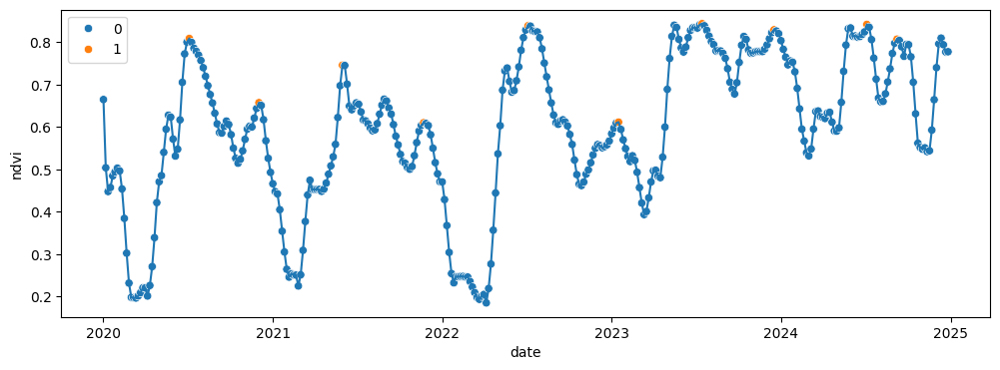

In [17]:
ndvi_peaks(df_subset)

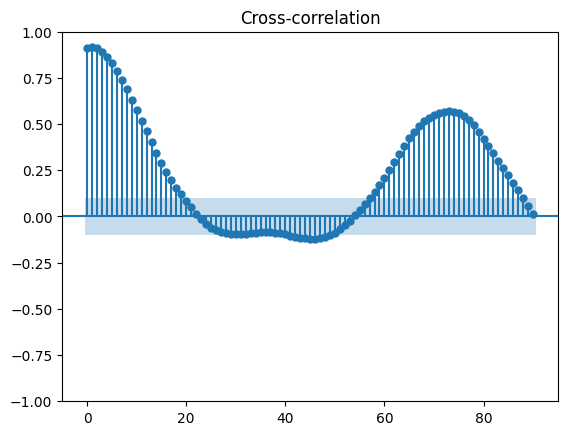

In [14]:
from statsmodels.graphics.tsaplots import plot_ccf

n = int(len(df_subset)/4)-1
plot_ccf(
    df_subset["ndvi"].values, 
    df_subset["ndmi"].values,
    lags=n,
    fft=True
)
plt.show()

In [15]:
def plot_vi_distribution(df: pd.DataFrame):
    df = df.copy()
    df = df[df["polygon_type"]=="Farm"]
    df["month"] = df["date"].dt.strftime("%b") # create a month column

    # Ensure months are in calendar order
    month_order = ["Jan", "Feb", "Mar", "Apr", "May", "Jun",
                   "Jul", "Aug", "Sep", "Oct", "Nov", "Dec"]
    df["month"] = pd.Categorical(df["month"], categories=month_order, ordered=True)
    df_melted = pd.melt(
        df,
        id_vars=["date", "month", "uuid", "polygon_type"],
        var_name="vi_type",
        value_name="vi_value"
    )
    df_melted["month_num"] = df_melted["month"].cat.codes
    
    boxplot = hv.BoxWhisker(
        df_melted,
        kdims=["month_num", "vi_type"],
        vdims='vi_value'
    ).opts(
        tools=["hover"],
        width=1000,
        height=500
    )

    display(boxplot)

plot_vi_distribution(df_smoothed)

:BoxWhisker   [month_num,vi_type]   (vi_value)

## Change-point detection

We saw that the NDVI and NDMI curves show a lack of periodic behavior during the last two years. Identifying such change-points is important for determining which farms have fallen into disuse, which can hint at crop failure. Furthermore, there can also be cases where a patch of land is used on alternating years for growing crops. Here we use the `ClaSP` algorithm to divide the sample NDVI time-series into semantically similar segments.

In [41]:
from sktime.detection.clasp import ClaSPSegmentation

clasp = ClaSPSegmentation(period_length=20)
pred = clasp.fit_predict(df_subset["ndvi"])

According to the ClaSP algorithm, the change-point starts at the 244-th time index in the data. The `ClaSP` algorithm has one hyperparameter, the `period_length` which is set to 10 by default. From the following line plots, we can clearly see that the change-point detection is very sensitive to $w$, with 5 and 10 producing the best results (for this example, at least).

In [17]:
pred["ilocs"] 

0    319
Name: ilocs, dtype: int64

In [42]:
def plot_clasp_profiles(df: pd.Series, w: list[int]):
    curve = hv.Curve([])
    maxima = hv.Scatter([])

    for val in w:
        clasp = ClaSPSegmentation(period_length=val)
        _ = clasp.fit_predict(df)
        profile = clasp.profiles[0]
        profile_max = (np.argmax(profile), profile[np.argmax(profile)])

        curve *= hv.Curve(profile, label=f"w={val}").opts(
            tools=["hover"],
            height=500,
            width=1000,
            title="ClaSP profiles",
            ylabel="ClaSP profiles",
            color=hv.Cycle("Category20"),
            show_legend=True
        )

        maxima *= hv.Scatter(profile_max).opts(
            tools=["hover"],
            size=7,
            line_color="black"
        )

    display(curve * maxima)

plot_clasp_profiles(df_subset["ndvi"], list(range(5, 80, 5)))

:Overlay
   .Curve.I           :Curve   [x]   (y)
   .Curve.W_equals_5  :Curve   [x]   (y)
   .Curve.W_equals_10 :Curve   [x]   (y)
   .Curve.W_equals_15 :Curve   [x]   (y)
   .Curve.W_equals_20 :Curve   [x]   (y)
   .Curve.W_equals_25 :Curve   [x]   (y)
   .Curve.W_equals_30 :Curve   [x]   (y)
   .Curve.W_equals_35 :Curve   [x]   (y)
   .Curve.W_equals_40 :Curve   [x]   (y)
   .Curve.W_equals_45 :Curve   [x]   (y)
   .Curve.W_equals_50 :Curve   [x]   (y)
   .Curve.W_equals_55 :Curve   [x]   (y)
   .Curve.W_equals_60 :Curve   [x]   (y)
   .Curve.W_equals_65 :Curve   [x]   (y)
   .Curve.W_equals_70 :Curve   [x]   (y)
   .Curve.W_equals_75 :Curve   [x]   (y)
   .Scatter.I         :Scatter   [x]   (y)
   .Scatter.II        :Scatter   [x]   (y)
   .Scatter.III       :Scatter   [x]   (y)
   .Scatter.IV        :Scatter   [x]   (y)
   .Scatter.V         :Scatter   [x]   (y)
   .Scatter.VI        :Scatter   [x]   (y)
   .Scatter.VII       :Scatter   [x]   (y)
   .Scatter.VIII      :Scatter   [x]   (y)
   .Scatter.IX        :Scatter   [x]   (y)
   .Scatter.X         :Scatter   [x]   (y)
   .Scatter.XI        :Scatter   [x]   (y)
   .Scatter.XII       :Scatter   [x]   (y)
   .Scatter.XIII      :Scatter   [x]   (y)
   .Scatter.XIV       :Scatter   [x]   (y)
   .Scatter.XV        :Scatter   [x]   (y)
   .Scatter.XVI       :Scatter   [x]   (y)

We observe that from 2023, the NDVI time-series does not show any periodic variations. This may point towards teh fact that the field fell into disuse.

In [43]:
from datetime import datetime

s1 = hv.Scatter(df_subset.iloc[0:319, :], "date", "ndvi").opts(tools=["hover"], size=7, line_color="black")
c1 = hv.Curve(df_subset.iloc[0:319, :], "date", "ndvi")
s2 = hv.Scatter(df_subset.iloc[319:, :], "date", "ndvi").opts(tools=["hover"], size=7, line_color="black")
c2 = hv.Curve(df_subset.iloc[319:, :], "date", "ndvi")

vspan = hv.VSpan(datetime(2024, 5, 15), datetime(2024, 12, 26)).opts(
    color="gray",
    alpha=0.25
)

(s1 * c1 * s2 * c2 * vspan).opts(
    width=1000
)

:Overlay
   .Scatter.I  :Scatter   [date]   (ndvi)
   .Curve.I    :Curve   [date]   (ndvi)
   .Scatter.II :Scatter   [date]   (ndvi)
   .Curve.II   :Curve   [date]   (ndvi)
   .VSpan.I    :VSpan   [x,y]

In [44]:
def apply_clasp(s: pd.Series, w: int=20):
    # This function applies ClaSP algorithm to the NDVI series corresponding to each uuid
    clasp = ClaSPSegmentation(period_length=w)
    pred = clasp.fit_predict(s)

    return pred["ilocs"].tolist() 

df_farm = df_smoothed[df_smoothed["polygon_type"]=="Farm"]

df_farm_cp = df_farm.groupby("uuid")["ndvi"].agg(apply_clasp)

In [21]:
df_farm_cp

uuid
00001a73-59d3-47a2-afc0-5d8daf4de3da    [264]
00045c8e-edef-4a08-a8a5-1f3e89692c8c    [137]
0009c0be-0069-4027-adbe-51adb7593d23    [323]
00152163-1574-4332-8309-52ef4656b855      [0]
001e2c1f-95bd-42ed-a828-6fa8be68fdf8    [248]
                                        ...  
ffdbbd61-a116-453b-858c-17c62c9bf12a    [182]
ffdfda11-0e8a-41d7-bb13-a286243aa113    [106]
ffe1674e-db37-488e-8044-d5fa74c532f5     [77]
ffe32c66-30d9-44fc-a3db-e3de8aa15146    [206]
ffe98956-cc46-4a1a-aeba-b2ca9de3ee19    [302]
Name: ndvi, Length: 7834, dtype: object

In [22]:
import ipywidgets as widgets
from IPython.display import display

plot_out = widgets.Output()

def plot_series(uuid: str):
    df_farm_uuid = df_farm[df_farm["uuid"]==uuid].copy()
    df_farm_uuid = df_farm_uuid.reset_index(drop=True)
    peaks, _ = find_peaks(
        df_farm_uuid["ndvi"].values, 
        height=(0.4, 1.0), 
        prominence=0.10, 
        distance=10
    )

    df_farm_uuid["peak"] = np.isin(df_farm_uuid.index, peaks).astype(int)

    idx = df_farm_cp.filter(items=[uuid]).iloc[0][0]
    
    with plot_out:
        plot_out.clear_output(wait=True)
        fig, ax1 = plt.subplots(figsize=(14, 5))
        
        # First segment
        sns.scatterplot(df_farm_uuid.iloc[:idx], x="date", y="ndvi", color="blue", hue="peak", s=75, legend=False, ax=ax1)
        sns.lineplot(df_farm_uuid.iloc[:idx], x="date", y="ndvi", color="blue", ax=ax1)
        
        # Second segment
        sns.scatterplot(df_farm_uuid.iloc[idx:], x="date", y="ndvi", color="green", hue="peak", s=75, legend=False, ax=ax1)
        sns.lineplot(df_farm_uuid.iloc[idx:], x="date", y="ndvi", color="green", ax=ax1)

        ax1.set_title(f"NDVI Over Time for UUID {uuid}")
        ax1.set_xlabel("Date")
        ax1.set_ylabel("NDVI")
        ax1.set_ylim(0, 1.0)
        ax1.legend()

        ax2 = ax1.twinx()
        ax2.plot(df_farm_uuid["date"].to_numpy(), np.gradient(df_farm_uuid["ndvi"].to_numpy()), c="r", alpha=0.5)
        plt.tight_layout()
        plt.show()


uuid_list = df_farm["uuid"].unique().tolist()
uuid_dropdown = widgets.Dropdown(options=uuid_list, description="UUID:")
uuid_dropdown.observe(lambda change: plot_series(change['new']), names='value')

ui = widgets.HBox([uuid_dropdown])
display(ui, plot_out)
plot_series(uuid_list[0])

Output()

In [18]:
def ndvi_peaks(df: pd.DataFrame) -> pd.DataFrame:
    """ 
    This function groups NDVI time-series data by uuid and applies
    peak-finding algorithm in order to identify NDVI peaks occurring
    in each identified farm.
    """
    df = df.copy()
    df = df[df["polygon_type"]=="Farm"]

    peaks_date_dict = {} # dictionary for storing dates where NDVI peaks occur for uuid
    peaks_val_dict = {}

    # Group by uuid
    for uuid, group in df.groupby("uuid"):
        group = group.reset_index(drop=True)
        peaks, _ = find_peaks(
            group["ndvi"].values, 
            height=(0.4, 1.0), 
            prominence=0.10, 
            distance=10
        )
        group["peak"] = np.isin(group.index, peaks).astype(int)
        
        # Extract dates where NDVI peaks occur and corresponding NDVI values
        ndvi_peak_dates = group[group["peak"] == 1]["date"].tolist()
        ndvi_peak_values = group[group["peak"] == 1]["ndvi"].tolist()

        peaks_date_dict[uuid] = ndvi_peak_dates    
        peaks_val_dict[uuid] = ndvi_peak_values

    """ 
    peaks_dict contains arrays of unequal lengths and, as such, cannot be used
    to construct a dataframe.
    """
    max_len = max(len(v) for v in peaks_date_dict.values())

    # Padding all arrays to the same length
    peaks_date_dict_padded = {
        k: v + [None]*(max_len - len(v)) for k, v in peaks_date_dict.items()
    }
    df_peaks_date = pd.DataFrame(peaks_date_dict_padded)

    peaks_val_dict_padded = {
        k: v + [None]*(max_len - len(v)) for k, v in peaks_val_dict.items()
    }
    df_peaks_val = pd.DataFrame(peaks_val_dict_padded)

    # Convert the wide form df to long form
    df_peaks_date["index"] = range(max_len)
    df_peaks_val["index"] = range(max_len)

    df_peaks_date_melted = pd.melt(df_peaks_date, id_vars="index", var_name="uuid", value_name="ndvi_peak_date").dropna()
    df_peaks_val_melted = pd.melt(df_peaks_val, id_vars="index", var_name="uuid", value_name="ndvi_peak_value").dropna()

    df_merged = df_peaks_date_melted.merge(df_peaks_val_melted, on=["uuid", "index"], how="inner")
    df_merged = df_merged.drop(columns="index")

    # Add a cumulative count to assign an order label to the peaks (eg. 1st, 2nd, 3rd,... peak of the year)
    df_merged["year"] = df_merged["ndvi_peak_date"].dt.year 
    df_merged["peak_position"] = (
        df_merged.groupby(["uuid", "year"]).cumcount() + 1
    ).astype("int")
    df_merged.drop(columns=["year"], inplace=True)

    return df_merged

In [19]:
df_peaks = ndvi_peaks(df_smoothed)

In [20]:
df_peaks

,uuid,ndvi_peak_date,ndvi_peak_value,peak_position
0,00001a73-59d3-47a2-afc0-5d8daf4de3da,2020-04-11,0.733686,1
1,00001a73-59d3-47a2-afc0-5d8daf4de3da,2020-07-25,0.720757,2
2,00001a73-59d3-47a2-afc0-5d8daf4de3da,2020-09-18,0.754274,3
3,00001a73-59d3-47a2-afc0-5d8daf4de3da,2020-12-02,0.754220,4
4,00001a73-59d3-47a2-afc0-5d8daf4de3da,2021-05-26,0.747247,1
...,...,...,...,...
74797,ffe98956-cc46-4a1a-aeba-b2ca9de3ee19,2024-01-11,0.617673,1
74798,ffe98956-cc46-4a1a-aeba-b2ca9de3ee19,2024-04-30,0.644554,2
74799,ffe98956-cc46-4a1a-aeba-b2ca9de3ee19,2024-07-04,0.685782,3
74800,ffe98956-cc46-4a1a-aeba-b2ca9de3ee19,2024-09-02,0.707278,4


In [26]:
#df_peaks.to_csv("data/ndvi_peaks_Trans_Nzoia_1.csv", index=False)

In [27]:
hv.BoxWhisker(
    df_peaks,
    kdims=["peak_position"],
    vdims=["ndvi_peak_value"]
).opts(
    tools=["hover"],
    width=500,
    xlabel="Position",
    ylabel="Peak NDVI value",
    title="NDVI peaks in relation to occurrence during year"
)

:BoxWhisker   [peak_position]   (ndvi_peak_value)

In [25]:
df_peaks["ndvi_peak_month"] = df_peaks["ndvi_peak_date"].dt.month
df_peaks["ndvi_peak_year"] = df_peaks["ndvi_peak_date"].dt.year

In [26]:
df_peaks

,uuid,ndvi_peak_date,ndvi_peak_value,peak_position,ndvi_peak_month,ndvi_peak_year
0,00001a73-59d3-47a2-afc0-5d8daf4de3da,2020-04-11,0.733686,1,4,2020
1,00001a73-59d3-47a2-afc0-5d8daf4de3da,2020-07-25,0.720757,2,7,2020
2,00001a73-59d3-47a2-afc0-5d8daf4de3da,2020-09-18,0.754274,3,9,2020
3,00001a73-59d3-47a2-afc0-5d8daf4de3da,2020-12-02,0.754220,4,12,2020
4,00001a73-59d3-47a2-afc0-5d8daf4de3da,2021-05-26,0.747247,1,5,2021
...,...,...,...,...,...,...
74797,ffe98956-cc46-4a1a-aeba-b2ca9de3ee19,2024-01-11,0.617673,1,1,2024
74798,ffe98956-cc46-4a1a-aeba-b2ca9de3ee19,2024-04-30,0.644554,2,4,2024
74799,ffe98956-cc46-4a1a-aeba-b2ca9de3ee19,2024-07-04,0.685782,3,7,2024
74800,ffe98956-cc46-4a1a-aeba-b2ca9de3ee19,2024-09-02,0.707278,4,9,2024


In [27]:
hv.Bars(df_peaks.groupby(["ndvi_peak_year", "ndvi_peak_month"]).agg(
        ndvi_peaks_per_month=pd.NamedAgg(column="ndvi_peak_date", aggfunc="count")
    ).reset_index(), kdims=["ndvi_peak_month", "ndvi_peak_year"]).opts(
        tools=["hover"],
        height=500,
        width=1000,
        xrotation=90,
        xlabel="Month",
        ylabel="Total NDVI peaks"
    ) * hv.VSpan(25, 44).opts(color="gray", alpha=0.25)* hv.VSpan(70, 76).opts(color="gray", alpha=0.25)

:Overlay
   .Bars.I   :Bars   [ndvi_peak_month,ndvi_peak_year]   (ndvi_peaks_per_month)
   .VSpan.I  :VSpan   [x,y]
   .VSpan.II :VSpan   [x,y]

In [28]:
df_peaks_per_farm=df_peaks.groupby(["ndvi_peak_year", "uuid"]).agg(
    number_of_peaks_per_farm=pd.NamedAgg(column="ndvi_peak_date", aggfunc="count")
).reset_index()

df_peak_multiplificty = df_peaks_per_farm.groupby(["ndvi_peak_year","number_of_peaks_per_farm"]).agg(
    uuid_count=pd.NamedAgg(column="uuid", aggfunc="count")
).reset_index()

df_peak_multiplificty

,ndvi_peak_year,number_of_peaks_per_farm,uuid_count
0,2020,1,1381
1,2020,2,4187
2,2020,3,1931
3,2020,4,311
4,2020,5,18
5,2021,1,2784
6,2021,2,3926
7,2021,3,1033
8,2021,4,83
9,2021,5,2


In [29]:
hv.Bars(
    df_peak_multiplificty, 
    kdims=["number_of_peaks_per_farm", "ndvi_peak_year"]
).opts(
    tools=["hover"],
    height=500,
    width=750,
    xrotation=90,
    xlabel="Number of annual NDVI peaks",
    ylabel="Number of farms"
)

:Bars   [number_of_peaks_per_farm,ndvi_peak_year]   (uuid_count)

$\chi^2$ test on the count data shows that the variations in the number of NDVI peaks are statistically significant. However, we should take into account that the data is far from perfect and the result is from one peak-finding parameter.

In [30]:
# as a pivot table

df_peak_pivoted = df_peak_multiplificty.pivot_table(
    index="number_of_peaks_per_farm",
    columns="ndvi_peak_year",
    values="uuid_count"
).astype("int")

df_peak_pivoted

ndvi_peak_year,2020,2021,2022,2023,2024
number_of_peaks_per_farm,,,,,
1,1381,2784,3486,1264,3025
2,4187,3926,3621,4407,3374
3,1931,1033,678,1856,1183
4,311,83,38,283,176
5,18,2,2,12,11


In [34]:
from scipy.stats import chi2_contingency

chi2, p, dof, expected = chi2_contingency(df_peak_pivoted)

p

np.float64(0.0)

In [31]:
gdf = gpd.read_file(
    "../inference/Trans_Nzoia_1_results_aggregated.gpkg",
    columns=["uuid", "prediction_decoded", "area (acres)", "geometry"]
)

gdf_farm = (
    gdf[gdf["prediction_decoded"]=="Farm"]
    .drop(columns="prediction_decoded")
    .reset_index(drop=True)
)

gdf_farm["centroid"] = gdf_farm["geometry"].centroid

In [32]:
gdf_farm.head()

,area (acres),uuid,geometry,centroid
0,0.378842,024ac1c2-25eb-43c5-8d9d-6f9c3b3cf727,"POLYGON ((35.02908 1.07685, 35.02908 1.0768, 3...",POINT (35.02932 1.07659)
1,1.693075,032e740b-b835-4bf1-889c-c7ffebb5ad62,"POLYGON ((34.99846 1.04698, 34.99846 1.04684, ...",POINT (34.99899 1.04651)
2,1.429261,03a059d2-3bf1-4920-b053-29c4afa4b014,"POLYGON ((35.01582 1.06036, 35.01582 1.06031, ...",POINT (35.01534 1.05982)
3,2.530782,043aae6f-2eda-4e6b-8ca3-90b5d521f815,"POLYGON ((35.01901 1.04553, 35.01901 1.0454, 3...",POINT (35.01908 1.0449)
4,0.473210,048ee68f-147b-431a-859a-0634431ffb1b,"POLYGON ((35.02859 1.06682, 35.02859 1.06673, ...",POINT (35.02864 1.06646)


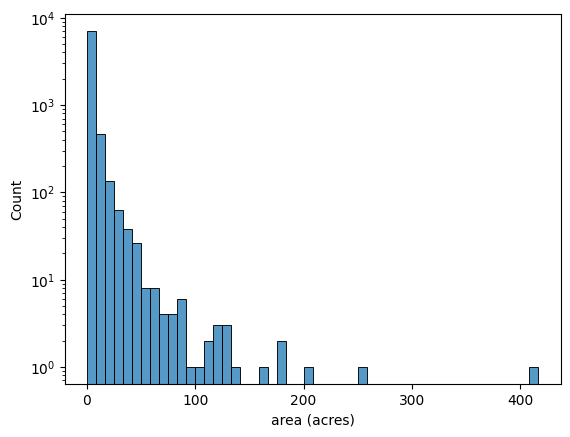

In [33]:
sns.histplot(gdf_farm, x="area (acres)", bins=50)
plt.yscale("log")

In [34]:
gdf_merged = gpd.GeoDataFrame(df_peaks_per_farm.merge(gdf_farm, on="uuid", how="right"))

gdf_merged.head()

,ndvi_peak_year,uuid,number_of_peaks_per_farm,area (acres),geometry,centroid
0,2020,024ac1c2-25eb-43c5-8d9d-6f9c3b3cf727,2,0.378842,"POLYGON ((35.02908 1.07685, 35.02908 1.0768, 3...",POINT (35.02932 1.07659)
1,2021,024ac1c2-25eb-43c5-8d9d-6f9c3b3cf727,2,0.378842,"POLYGON ((35.02908 1.07685, 35.02908 1.0768, 3...",POINT (35.02932 1.07659)
2,2022,024ac1c2-25eb-43c5-8d9d-6f9c3b3cf727,1,0.378842,"POLYGON ((35.02908 1.07685, 35.02908 1.0768, 3...",POINT (35.02932 1.07659)
3,2023,024ac1c2-25eb-43c5-8d9d-6f9c3b3cf727,3,0.378842,"POLYGON ((35.02908 1.07685, 35.02908 1.0768, 3...",POINT (35.02932 1.07659)
4,2024,024ac1c2-25eb-43c5-8d9d-6f9c3b3cf727,2,0.378842,"POLYGON ((35.02908 1.07685, 35.02908 1.0768, 3...",POINT (35.02932 1.07659)


In [35]:
from matplotlib.colors import ListedColormap

unique_vals = sorted(gdf_merged["number_of_peaks_per_farm"].dropna().unique())
colors = plt.cm.Set1.colors  # or use another discrete colormap

# Ensure enough colors
if len(unique_vals) > len(colors):
    raise ValueError("Not enough colors for unique values. Use a bigger colormap or define your own.")

# Create ListedColormap with appropriate length
cmap = ListedColormap(colors[:len(unique_vals)])

# m = gdf_merged[
#     gdf_merged["ndvi_peak_year"]==2020
# ].set_geometry("geometry").explore(
#     style_kwds=dict(color="green", opacity=0.4, fillOpacity=0.25)
# )

gdf_merged[
    gdf_merged["ndvi_peak_year"]==2020
].explore(
    column="number_of_peaks_per_farm",
    cmap=cmap,
    legend=True,
    categorical=True
)

In [40]:
hv.Scatter(
    gdf_merged, kdims=["number_of_peaks_per_farm"], vdims=["area (acres)"]
).opts(
    height=500,
    width=500,
    size=10,
    line_color="black"
)

:Scatter   [number_of_peaks_per_farm]   (area (acres))

In [45]:
gdf_ts = gpd.GeoDataFrame(
    df_farm.merge(gdf_farm, on="uuid", how="inner"),
    geometry="geometry"
)

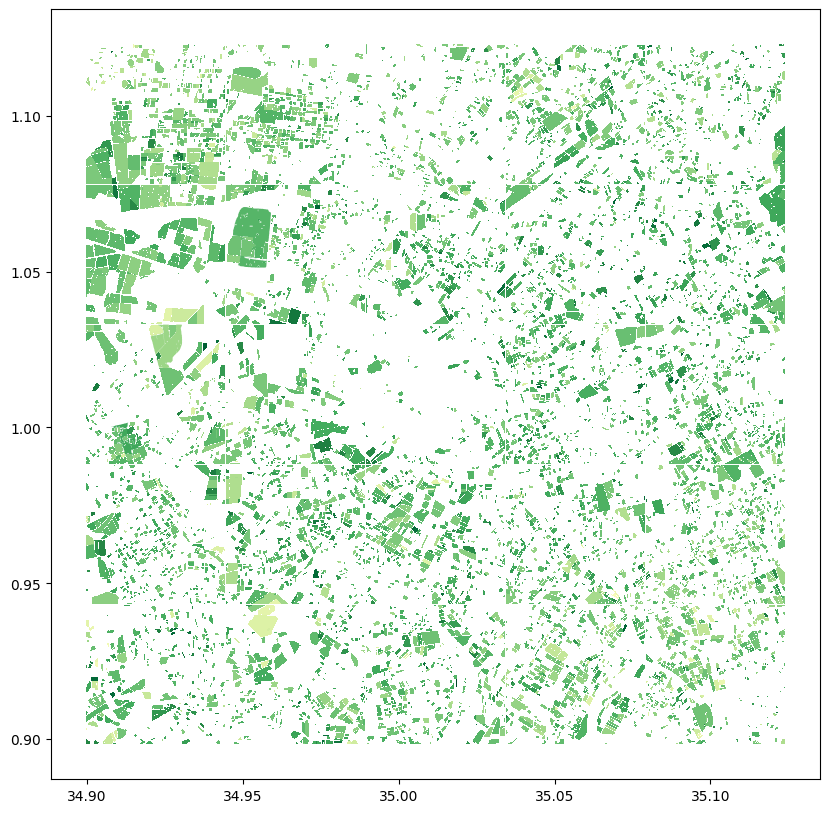

In [46]:
import matplotlib.colors as mcolors
import matplotlib.cm as cm
from matplotlib.animation import FuncAnimation

# Set global NDMI range
vmin = gdf_ts["ndmi"].min()
vmax = gdf_ts["ndmi"].max()

# Set colormap
cmap = "YlGn" 

fig, ax = plt.subplots(figsize=(10, 10))

initial_frame = gdf_ts[gdf_ts["date"] == gdf_ts["date"].unique()[0]]
collection = initial_frame.plot(
    ax=ax, 
    column="ndmi", 
    cmap=cmap, 
    vmin=vmin, 
    vmax=vmax, 
    legend=False
)

In [43]:
# norm = mcolors.Normalize(vmin=vmin, vmax=vmax)
# sm = cm.ScalarMappable(norm=norm, cmap=cmap)
# sm._A = []  # Required to avoid warnings
# cbar = fig.colorbar(sm, ax=ax)
# cbar.set_label("NDMI", fontsize=12)

# def update(frame):
#     ax.clear()

#     # Maintain axis labels and colorbar layout
#     ax.set_xlabel("Longitude", fontsize=12)
#     ax.set_ylabel("Latitude", fontsize=12)

#     # Get current frame data
#     frame_data = gdf_ts[gdf_ts["date"] == gdf_ts["date"].unique()[frame]]
#     frame_data.plot(
#         ax=ax, 
#         column="ndmi", 
#         cmap=cmap, 
#         vmin=vmin, 
#         vmax=vmax, 
#         legend=False
#     )

#     ax.set_title(f"Date: {frame_data['date'].iloc[0].strftime('%Y-%m-%d')}")

# # Animate
# ani = FuncAnimation(fig, update, frames=len(gdf_ts["date"].unique()), repeat=True)

# # Save to file
# ani.save("ndmi_timelapse.mp4", writer='ffmpeg')

## High NDMI regions

Although it is unclear which metric is best suited to determine whether or not a parcel of land is irrigated, we can use the NDMI value as an indicator. We know that the NDMI tracks the NDVI without much lag and a high value during growing season can indicate possible irrigation. We categorize the moisture levels as follows

* $\rm{NDMI}\geq 0.38$ - high moisture content
* $0.2\leq\rm{NDMI}<0.38$ - moderate moisture content
* $\rm{NDMI} < 0.2$ - low moisture content

We first calculate the number of annual days during which a farm experiences $\rm{NDMI}\geq 0.38$, furthering filtering the list down to contain only those that see high levels for 30 days or greater per year.

In [47]:
df_high_ndmi = df_farm[df_farm["ndmi"] >= 0.38]
df_high_ndmi["year"] = df_high_ndmi["date"].dt.year

df_high_ndmi_days = pd.DataFrame(
    df_high_ndmi.groupby(["uuid", "year"]).apply(
        lambda x: pd.Series({"high_ndmi_days": (x["date"].max() - x["date"].min()).days})
    )
).reset_index()

#df_high_ndmi_days["high_ndmi_days"] = df_high_ndmi_days["high_ndmi_days"].apply(lambda x: x.split(" ")[0].astype("int"))

df_high_ndmi_days

,uuid,year,high_ndmi_days
0,00152163-1574-4332-8309-52ef4656b855,2021,45
1,00152163-1574-4332-8309-52ef4656b855,2022,15
2,00152163-1574-4332-8309-52ef4656b855,2023,20
3,00152163-1574-4332-8309-52ef4656b855,2024,10
4,009bf3fd-7370-4fdf-9e79-08d783aa792e,2022,10
...,...,...,...
4329,ffc5bffd-d702-4f76-96ba-8d8a470a5b31,2022,5
4330,ffc5bffd-d702-4f76-96ba-8d8a470a5b31,2024,20
4331,ffc6c030-1bdb-416d-a8ba-1bc7b64d7624,2020,25
4332,ffc6c030-1bdb-416d-a8ba-1bc7b64d7624,2022,50


In [45]:
print(f"Number of farm polygons with at least one NDMI point greater than 0.38: {len(df_high_ndmi['uuid'].unique())}")

Number of farm polygons with at least one NDMI point greater than 0.38: 1676


### Distributions
Observing the distribution of `high_ndmi_days`, we can see that the occurrences are constrained within 0 to 100 days, with larger values appearing as outliers. Over the 5 years, the `high_ndmi_days` upper quartile hovers around 30 to 40 days. The polygons which experience high NDMI for a large number of days annually may also be misclassifications (groups of trees) or maybe patches of land with extended periods of irrigation.

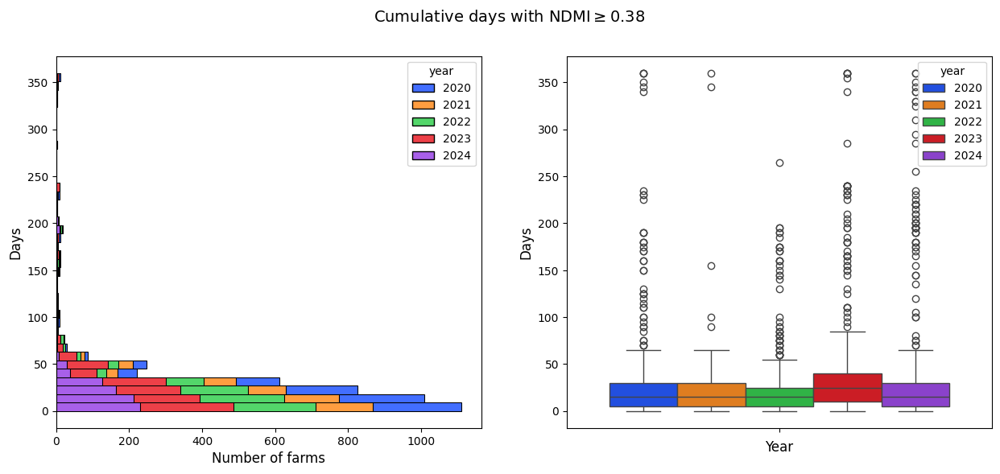

In [48]:
fig, ax = plt.subplots(1, 2, figsize=(15, 6))
sns.histplot(df_high_ndmi_days, y="high_ndmi_days", hue="year", multiple="stack", bins=40, palette="bright", ax=ax[0])
ax[0].set_xlabel("Number of farms", fontsize=12)
ax[0].set_ylabel("Days", fontsize=12)

sns.boxplot(df_high_ndmi_days, y="high_ndmi_days", hue="year", palette="bright", ax=ax[1])
ax[1].set_xlabel("Year", fontsize=12)
ax[1].set_ylabel("Days", fontsize=12)

fig.suptitle(r"Cumulative days with NDMI$\geq0.38$", fontsize=14)
plt.show()

In [49]:
df_high_ndmi_days.groupby("year").describe()

high_ndmi_days                                                    
              count       mean        std  min   25%   50%   75%    max
year                                                                   
2020          935.0  25.005348  39.020049  0.0   5.0  15.0  30.0  360.0
2021          585.0  20.743590  25.498507  0.0   5.0  15.0  30.0  360.0
2022          851.0  22.420682  28.643106  0.0   5.0  15.0  25.0  265.0
2023         1095.0  31.776256  43.492631  0.0  10.0  25.0  40.0  360.0
2024          868.0  30.368664  52.911016  0.0   5.0  15.0  30.0  360.0

There is no relationship between polygon area and the number of days spend in high NDMI zone. However, most of the bigger polygons lie within the upper quartile of the distribution.

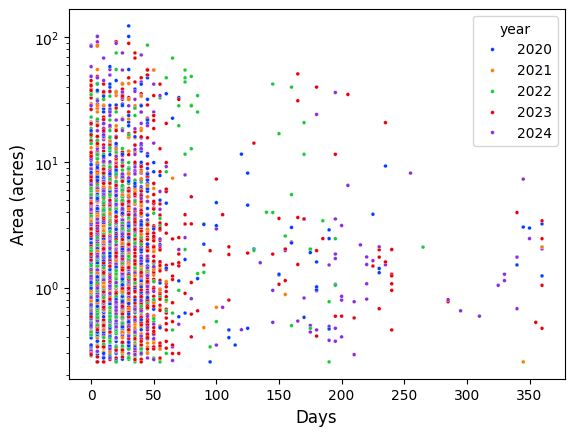

In [50]:
sns.scatterplot(
    df_high_ndmi_days.merge(gdf_farm, on="uuid", how="left"),
    x="high_ndmi_days",
    y="area (acres)",
    hue="year",
    s=7.5, 
    palette="bright"
)
plt.xlabel("Days", fontsize=12)
plt.ylabel("Area (acres)", fontsize=12)
plt.yscale("log")
plt.show()

In [51]:
def high_ndmi_regions(gdf: gpd.GeoDataFrame, df: pd.DataFrame, year: int):

    gdf_high_ndmi_days = gpd.GeoDataFrame(
        df.merge(gdf, on="uuid", how="inner")
    )

    gdf_subset = gdf_high_ndmi_days[
        (gdf_high_ndmi_days["year"]==year) & (gdf_high_ndmi_days["high_ndmi_days"] >= 30)
    ]

    # Min-max for `high_ndmi_days`
    vmin = gdf_subset["high_ndmi_days"].min()
    vmax = gdf_subset["high_ndmi_days"].max()

    norm = mcolors.Normalize(vmin=vmin, vmax=vmax)
    cmap = "viridis"
    sm = cm.ScalarMappable(norm=norm, cmap=cmap)
    cbar = fig.colorbar(sm, ax=ax)
    cbar.set_label("days", fontsize=12)

    m = gdf_subset.explore(
        column="high_ndmi_days",
        cmap=cmap,
        vmin=vmin,
        vmax=vmax,
        tiles="Cartodb positron",
        legend=True,
        tooltip=["uuid", "high_ndmi_days"]
    )

    display(m)

In [52]:
high_ndmi_regions(gdf_farm, df_high_ndmi_days, 2023)

In [53]:
def peak_vi_distribution(df: pd.DataFrame):
    df_subset = df
    df_subset["year"] = df_subset["date"].dt.year 

    df_grouped = df_subset.groupby(["uuid", "year"])[["ndvi", "ndmi"]].apply(lambda x: x.max())
    df_grouped.rename(columns={"ndvi": "ndvi_max", "ndmi": "ndmi_max"}, inplace=True)

    return df_grouped

### 5-year aggregate
The 5-year aggregates of peak NDMI can reveal which farms have higher water stress and likely to experience problems with crop growth. In particular, we can classify the farms using the 5-year mean of `ndmi_max` as a means of assessing the potential of crop failure, drought and other metrics.

* $\rm{NDMI}_{\rm{max}}\geq0.28$ - high moisture
* $0.25\leq\rm{NDMI}_{\rm{max}} < 0.38$ - moderate moisture
* $0.20 \leq\rm{NDMI}_{\rm{max}} < 0.25$ - approaching low moisture
* $\rm{NDMI}_{\rm{max}}< 0.20$ - low moisture

The Trans-Nzoia region receives significant precipitation, so it is natural to expect rainfed farms perform well in terms of crop yields. Nevertheless, farms with low moisture or ones that are approaching low moisture can be investigated.

In [76]:
df_vi_peak = peak_vi_distribution(df_farm)

df_vi_peak.reset_index()

,uuid,year,ndvi_max,ndmi_max
0,00001a73-59d3-47a2-afc0-5d8daf4de3da,2020,0.754274,0.288198
1,00001a73-59d3-47a2-afc0-5d8daf4de3da,2021,0.747247,0.301773
2,00001a73-59d3-47a2-afc0-5d8daf4de3da,2022,0.628134,0.167410
3,00001a73-59d3-47a2-afc0-5d8daf4de3da,2023,0.614893,0.129695
4,00001a73-59d3-47a2-afc0-5d8daf4de3da,2024,0.766620,0.361839
...,...,...,...,...
39165,ffe98956-cc46-4a1a-aeba-b2ca9de3ee19,2020,0.677968,0.225680
39166,ffe98956-cc46-4a1a-aeba-b2ca9de3ee19,2021,0.672102,0.251887
39167,ffe98956-cc46-4a1a-aeba-b2ca9de3ee19,2022,0.721921,0.266610
39168,ffe98956-cc46-4a1a-aeba-b2ca9de3ee19,2023,0.675651,0.270863


In [62]:
def max_ndmi_polygons(df: pd.DataFrame, gdf: gpd.GeoDataFrame):
    gdf_merged = gpd.GeoDataFrame(
        df.merge(gdf, on="uuid", how="left"),
        geometry="geometry"
    )

    gdf_merged = gdf_merged[gdf_merged["ndmi_max"] > 0]
    gdf_agg = gpd.GeoDataFrame(gdf_merged.groupby("uuid").agg(
        {
            "ndmi_max": "mean",
            "geometry": "first"
        }
    )).reset_index()

    vmin = gdf_merged["ndmi_max"].min()
    vmax = gdf_merged["ndmi_max"].max()

    norm = mcolors.Normalize(vmin=vmin, vmax=vmax)
    cmap = "turbo_r"
    sm = cm.ScalarMappable(norm=norm, cmap=cmap)
    cbar = fig.colorbar(sm, ax=ax)
    cbar.set_label("days", fontsize=12)

    m = gdf_agg.explore(
        column="ndmi_max",
        cmap=cmap,
        vmin=vmin,
        vmax=vmax,
        tiles="Cartodb dark matter",
        legend=True,
        tooltip=["uuid", "ndmi_max"]
    )

    display(m)

    return gdf_agg

In [63]:
gdf_ndmi_max = max_ndmi_polygons(df_vi_peak.reset_index(), gdf_farm)

In [73]:
gdf_ndmi_max["category"] = gdf_ndmi_max["ndmi_max"].apply(
    lambda x: "high" if x >=0.4 else "medium" if 0.25 <= x < 0.4 else "approaching low" if 0.20 <= x < 0.25 else "low"
)

gdf_ndmi_max.head()

,uuid,ndmi_max,geometry,category
0,00001a73-59d3-47a2-afc0-5d8daf4de3da,0.249783,"POLYGON ((34.93556 1.0674, 34.93556 1.06736, 3...",approaching low
1,00045c8e-edef-4a08-a8a5-1f3e89692c8c,0.231682,"POLYGON ((35.04301 0.94377, 35.04301 0.94373, ...",approaching low
2,0009c0be-0069-4027-adbe-51adb7593d23,0.309869,"POLYGON ((34.97616 1.04897, 34.97616 1.04879, ...",medium
3,00152163-1574-4332-8309-52ef4656b855,0.407124,"POLYGON ((34.94838 1.03591, 34.94838 1.03582, ...",high
4,001e2c1f-95bd-42ed-a828-6fa8be68fdf8,0.322050,"POLYGON ((35.09596 0.95783, 35.09596 0.95778, ...",medium


In [75]:
gdf_ndmi_max.to_file("data/ndmi_max_polygons_Trans_Nzoia_1.shp")

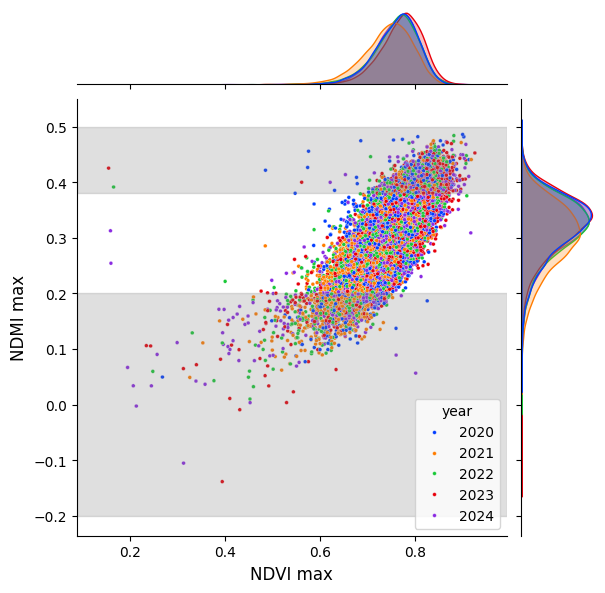

In [65]:
sns.jointplot(df_vi_peak.reset_index(), x="ndvi_max", y="ndmi_max", s=7.5, hue="year", palette="bright")
plt.axhspan(0.38, 0.5, color="gray", alpha=0.25)
plt.axhspan(-0.2, 0.2, color="gray", alpha=0.25)
plt.xlabel(r"NDVI max", fontsize=12)
plt.ylabel("NDMI max", fontsize=12)
plt.show()

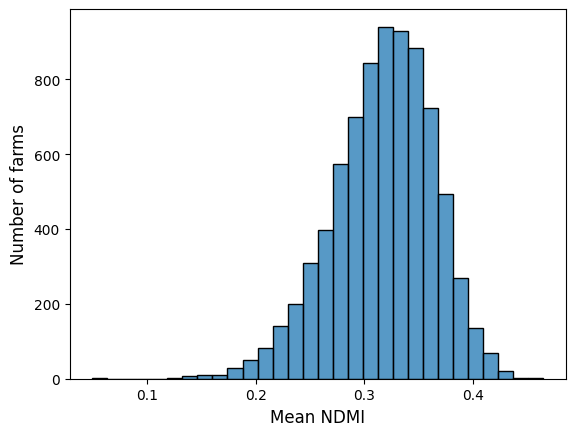

In [66]:
mean_ndmi_max = pd.DataFrame(df_vi_peak.reset_index().groupby("uuid")["ndmi_max"].agg("mean"))

sns.histplot(mean_ndmi_max, x="ndmi_max", bins=30)
plt.xlabel("Mean NDMI", fontsize=12)
plt.ylabel("Number of farms", fontsize=12)
plt.show()

In [68]:
mean_ndmi_max["moisture_content"]=mean_ndmi_max["ndmi_max"].apply(
    lambda x: "high" if x >=0.4 else "medium" if 0.25 <= x < 0.4 else "approaching low" if 0.20 <= x < 0.25 else "low"
)
mean_ndmi_max= mean_ndmi_max.reset_index()

In [69]:
moisture_content = mean_ndmi_max.groupby("moisture_content").agg(
    counts=pd.NamedAgg("ndmi_max", aggfunc="count")
).reset_index()
moisture_content

,moisture_content,counts
0,approaching low,569
1,high,168
2,low,104
3,medium,6993


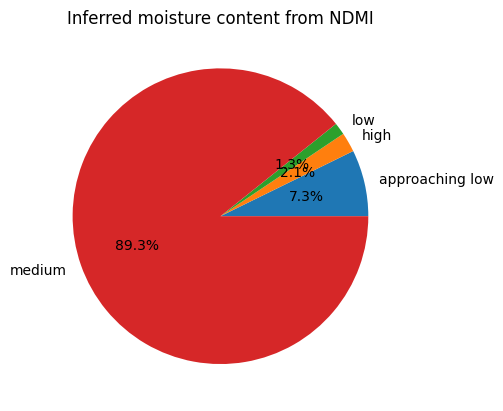

In [77]:
plt.pie(moisture_content["counts"], labels=moisture_content["moisture_content"], autopct="%1.1f%%")
plt.title("Inferred moisture content from NDMI")
plt.show()

## Integration with iSDAsoil data

## Integrated NDVI

The the NDVI metric gives us a good indication of crop growth and annual crop cycles. However, it does not provide any such indication towards crop yield trends. For such cases, we can use the integrated NDVI (iNDVI). The iNDVI is calculated as
$$ \rm{iNDVI} = \int_{t_i}^{t_f}dt\:\rm{NDVI}(t) $$
When performed over growing seasons, the iNDVI provides us with a measure of total photosynthetic activity. In the figure below, we consider a particular farm and mark out growing seasons across all five years. The start-of-season (SOS) is identified as the point early in the year when the NDVI exceeds 0.3. The end-of-season (EOS) is identified as the point in time when the NDVI experiences are sharp drop.

In [60]:
# df_example = df[df["uuid"]=="00af89e1-1537-49a7-9508-47eff2d2bfc1"]

# display(
#     hv.Curve(df_example, "date", "ndvi").opts(
#     tools=["hover"],
#     width=1000,
#     height=400,
#     line_width=4
# )*hv.VSpan(datetime(2020,4,21), datetime(2020, 10, 23)).opts(color="gray", alpha=0.25)
#  *hv.VSpan(datetime(2021,4,26), datetime(2021, 11, 2)).opts(color="gray", alpha=0.25)
#  *hv.VSpan(datetime(2022,5,6), datetime(2022, 10, 23)).opts(color="gray", alpha=0.25)
#  *hv.VSpan(datetime(2023,4,16), datetime(2023, 9, 13)).opts(color="gray", alpha=0.25)
#  *hv.VSpan(datetime(2024,5,10), datetime(2024, 11, 11)).opts(color="gray", alpha=0.25)
# )


In [61]:
# from scipy.integrate import simpson

# def calculate_iNDVI(
#         df: pd.DataFrame,
#         growing_seasons: list[tuple[datetime]]
#     ) -> tuple[list, list]:
#     """
#     This function calculates the iNDVI for the given time-series by
#     integrating it during the provided growing seasons
#     """
#     df = df.copy()
#     df = df.set_index("date") # For easier indexing

#     year = []
#     iNDVI = []
#     for dates in growing_seasons:
#         sos = dates[0]
#         eos = dates[1]

#         y = df.loc[sos:eos, "ndvi"].to_numpy()
#         x = np.arange(len(y))

#         auc = simpson(y, x)
#         year.append(sos.year)
#         iNDVI.append(auc)

#     return year, iNDVI

In [62]:
# growing_seasons = [
#     (datetime(2020,4,21), datetime(2020, 10, 23)),
#     (datetime(2021,4,26), datetime(2021, 11, 2)),
#     (datetime(2022,5,6), datetime(2022, 10, 23)),
#     (datetime(2023,4,16), datetime(2023, 9, 13)),
#     (datetime(2024,5,10), datetime(2024, 11, 11))
# ]

# year, iNDVI = calculate_iNDVI(df_example, growing_seasons)

In [63]:
# (hv.Scatter((year, iNDVI)).opts(size=7.5, line_color="black")*hv.Curve((year, iNDVI))).opts(
#     tools=["hover"],
#     width=500,
#     height=300,
#     xlabel="Year",
#     ylabel="iNDVI"
# )